# Advanced topics- t-SNE on SKin dataset 

In [1]:
%matplotlib inline
import os
import matplotlib
import matplotlib.pyplot as plt
from matplotlib.offsetbox import OffsetImage, AnnotationBbox
import cv2
import numpy as np
from glob import glob
import matplotlib.cm as cm
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import StandardScaler

BASE_DATA_FOLDER = "../input/covid19-image-dataset/Covid19-dataset"
TRAin_DATA_FOLDER = os.path.join(BASE_DATA_FOLDER, "train")


BASE_DATA_FOLDER = "../input/skin-cancer-dataset-original"
TRAin_DATA_FOLDER = os.path.join(BASE_DATA_FOLDER, "Skin cancer ISIC")


In [42]:
def visualize_scatter_with_images(X_2d_data, images, figsize=(30,30), image_zoom=1):
    fig, ax = plt.subplots(figsize=figsize)
    artists = []
    for xy, i in zip(X_2d_data, images):
        x0, y0 = xy
        img = OffsetImage(i, zoom=image_zoom)
        ab = AnnotationBbox(img, (x0, y0), xycoords='data', frameon=False)
        artists.append(ax.add_artist(ab))
    ax.update_datalim(X_2d_data)
    ax.autoscale()
    plt.show()

def visualize_scatter(data_2d, label_ids, figsize=(15,15)):
    plt.figure(figsize=figsize)
    plt.grid()
    
    nb_classes = len(np.unique(label_ids))
    
    for label_id in np.unique(label_ids):
        plt.scatter(data_2d[np.where(label_ids == label_id), 0],
                    data_2d[np.where(label_ids == label_id), 1],
                    marker='o',
                    color= plt.cm.Set1(label_id / float(nb_classes)),
                    linewidth='1',
                    alpha=0.8,
                    label=id_to_label_dict[label_id])
    plt.legend(loc='best')



In [25]:
img_size = 112


images = []
labels = []

for class_folder_name in os.listdir(TRAin_DATA_FOLDER):
    class_folder_path = os.path.join(TRAin_DATA_FOLDER, class_folder_name)
    for image_path in glob(os.path.join(class_folder_path, "*.jpeg")):
        image = cv2.imread(image_path, cv2.IMREAD_COLOR)
        
        #image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        image = cv2.resize(image, (img_size,img_size))
        
        image = image.flatten()
        
        images.append(image)
        labels.append(class_folder_name)
    for image_path in glob(os.path.join(class_folder_path, "*.png")):
        image = cv2.imread(image_path, cv2.IMREAD_COLOR)
        
        #image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        image = cv2.resize(image, (img_size,img_size))
        
        image = image.flatten()
        
        images.append(image)
        labels.append(class_folder_name)
    for image_path in glob(os.path.join(class_folder_path, "*.jpg")):
        image = cv2.imread(image_path, cv2.IMREAD_COLOR)
        
        #image = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)
        image = cv2.resize(image, (img_size,img_size))
        
        image = image.flatten()
        
        images.append(image)
        labels.append(class_folder_name)
        
images = np.array(images)
labels = np.array(labels)

labels

array(['pigmented benign keratosis', 'pigmented benign keratosis',
       'pigmented benign keratosis', ..., 'nevus', 'nevus', 'nevus'],
      dtype='<U26')

In [26]:
images

array([[150, 131, 152, ..., 114,  96, 119],
       [153, 136, 169, ..., 132, 125, 159],
       [159, 170, 246, ..., 158, 171, 226],
       ...,
       [114, 129, 147, ...,  70,  81, 111],
       [ 31,  38,  57, ...,  30,  28,  34],
       [ 69,  65,  76, ..., 137, 139, 140]], dtype=uint8)

In [27]:
label_to_id_dict = {v:i for i,v in enumerate(np.unique(labels))}
id_to_label_dict = {v: k for k, v in label_to_id_dict.items()}

label_ids = np.array([label_to_id_dict[x] for x in labels])

images_scaled = StandardScaler().fit_transform(images)

In [28]:
images_scaled.shape

(2357, 37632)

In [29]:
label_ids.shape

(2357,)

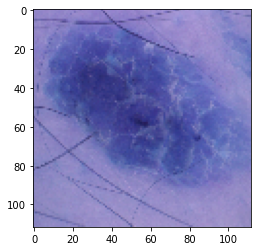

In [33]:
plt.imshow(np.reshape(images[15], (112,112,3)), cmap="gray")

In [34]:
pca = PCA(n_components=180)
pca_result = pca.fit_transform(images_scaled)
pca_result.shape

(2357, 180)

# t-SNE

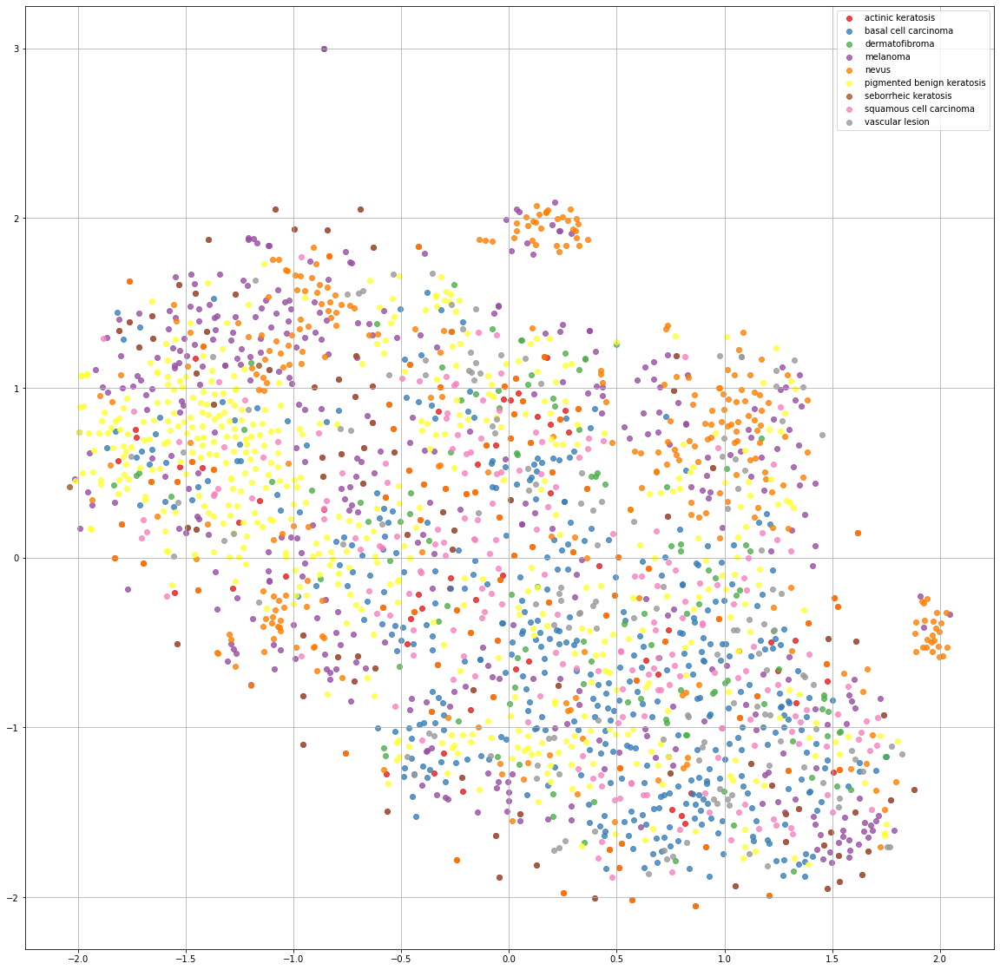

In [37]:
tsne = TSNE(n_components=2, perplexity=50.0 ,  learning_rate= 100.0, n_iter= 4000)
tsne_result = tsne.fit_transform(pca_result)
tsne_result_scaled = StandardScaler().fit_transform(tsne_result)
visualize_scatter(tsne_result_scaled, label_ids)



visualize_scatter_with_images(tsne_result_scaled, images = [np.reshape(i, (112,112,3)) for i in images], image_zoom=0.4)

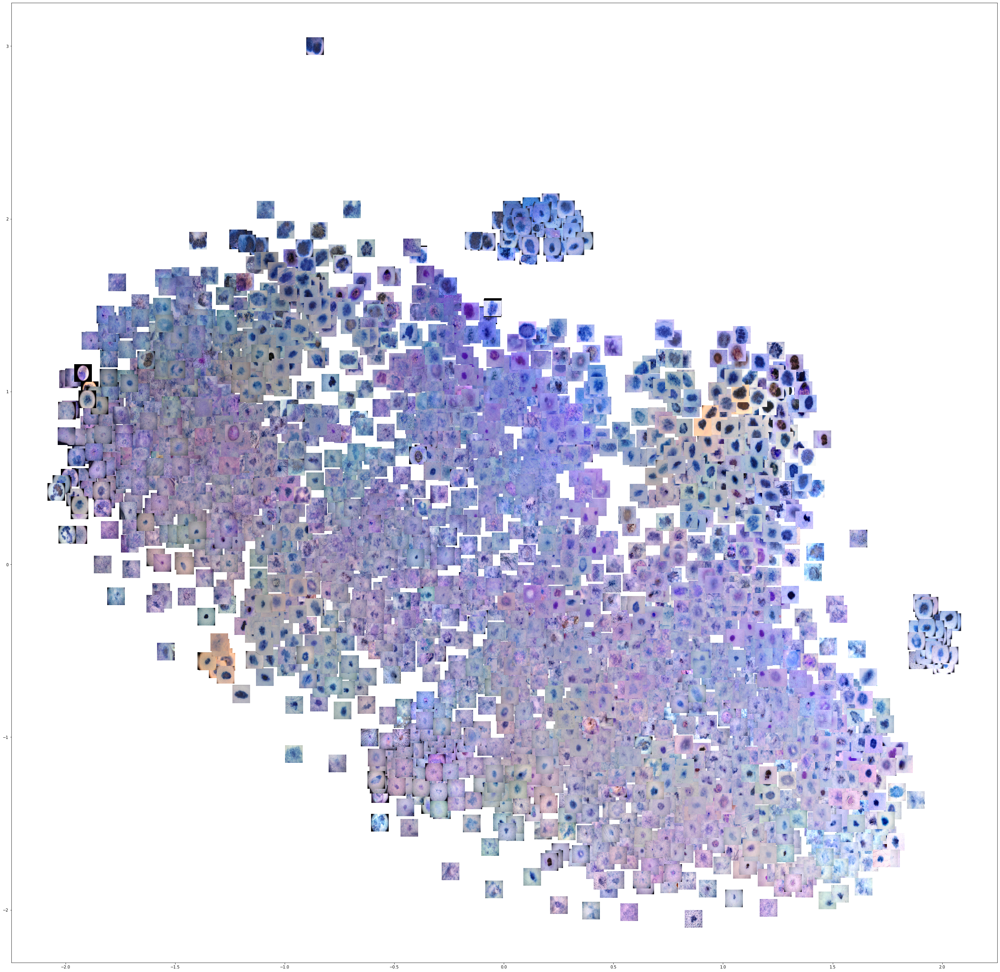

In [40]:
visualize_scatter_with_images(tsne_result_scaled, images = [np.reshape(i, (112,112,3)) for i in images], image_zoom=0.4)

# Effect of learning rate

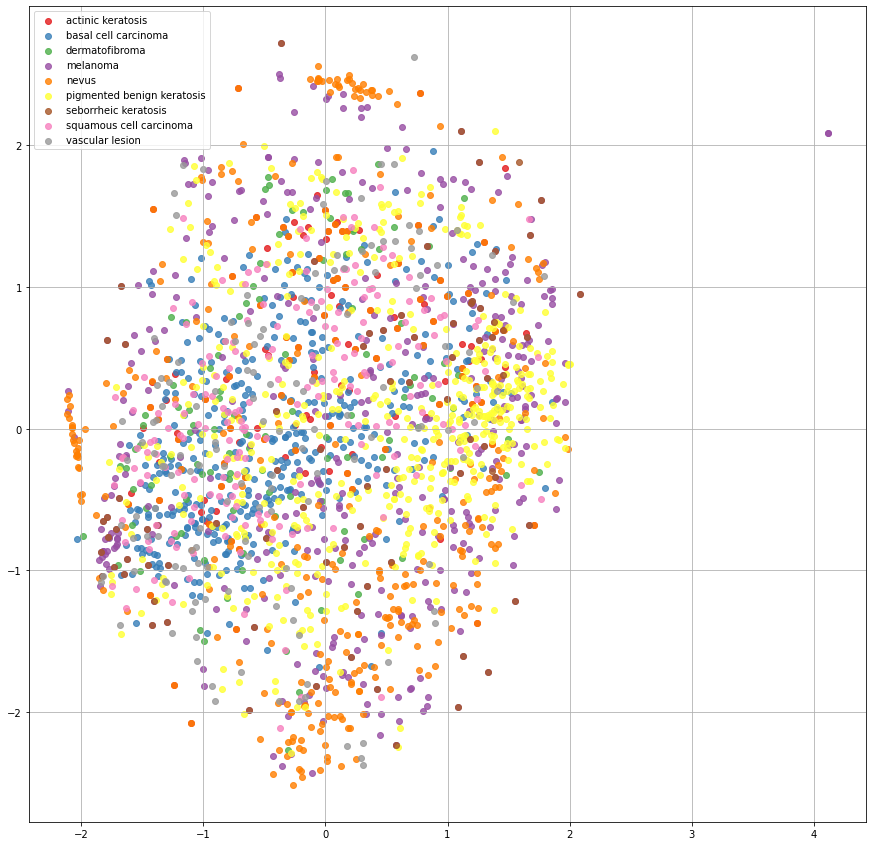

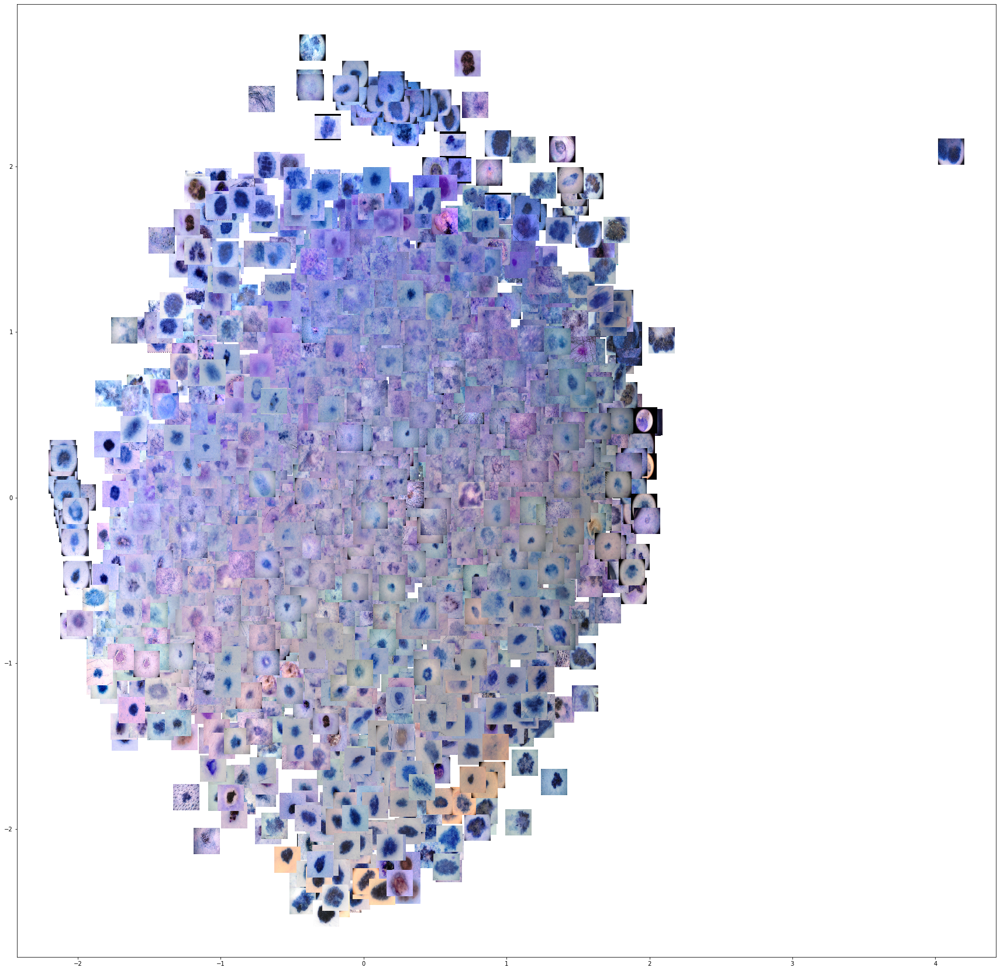

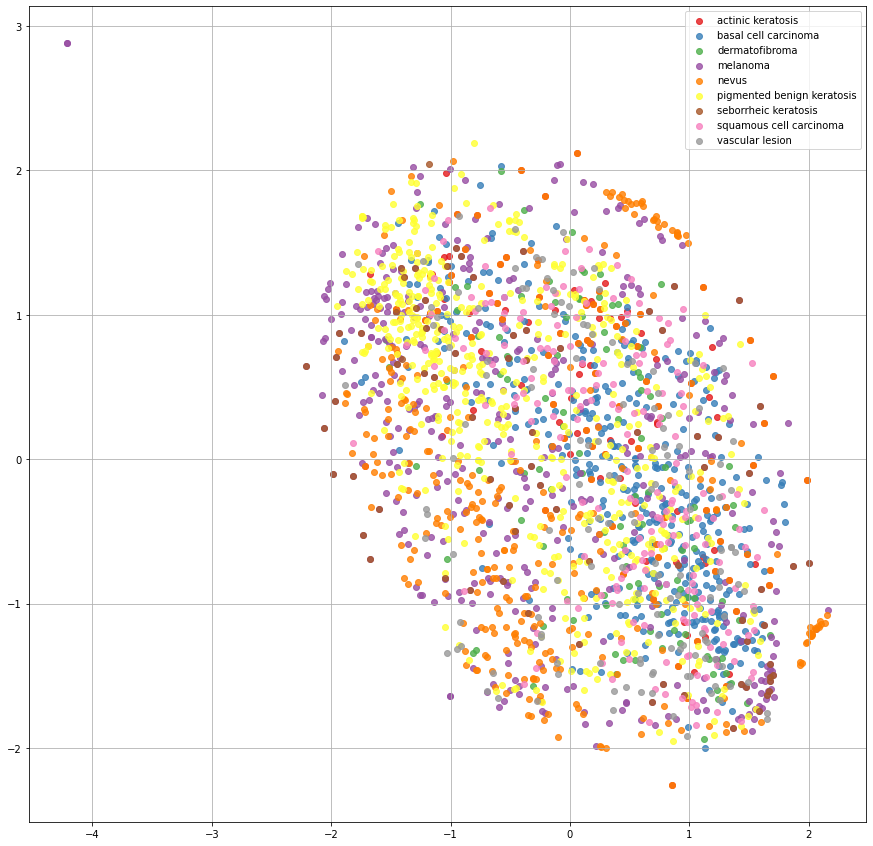

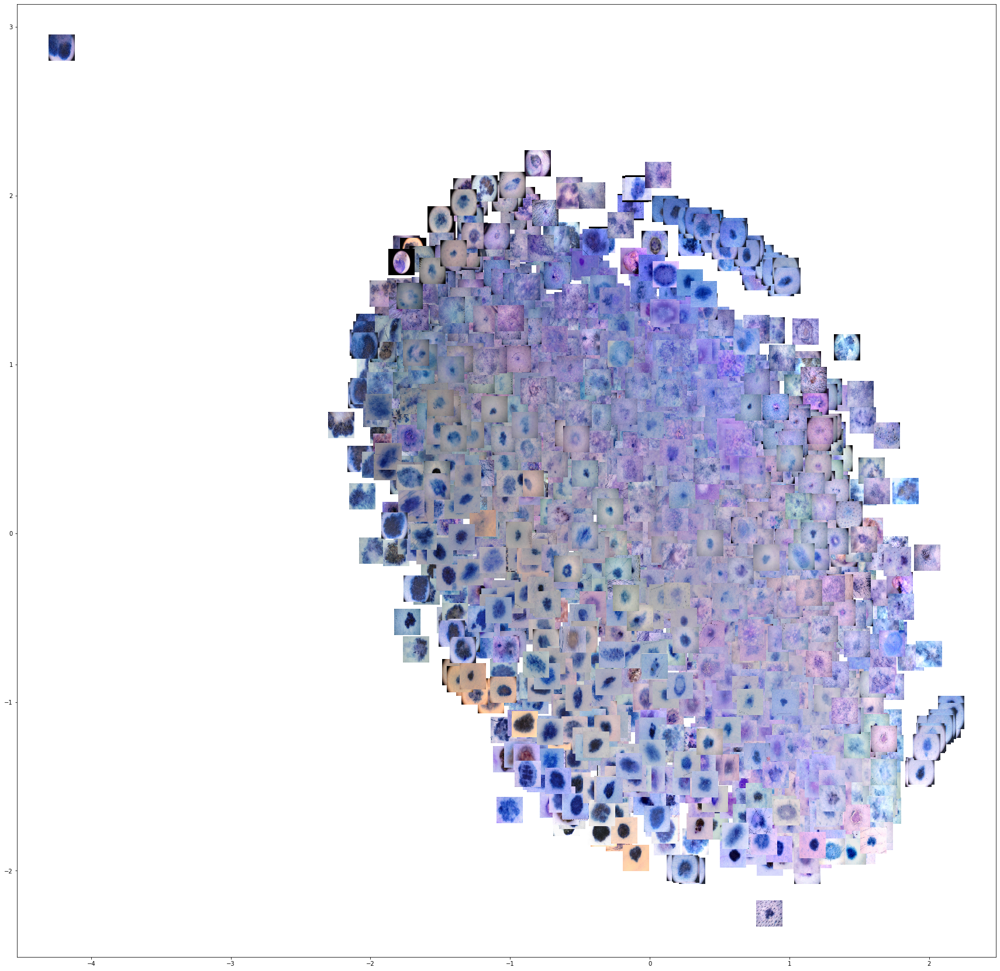

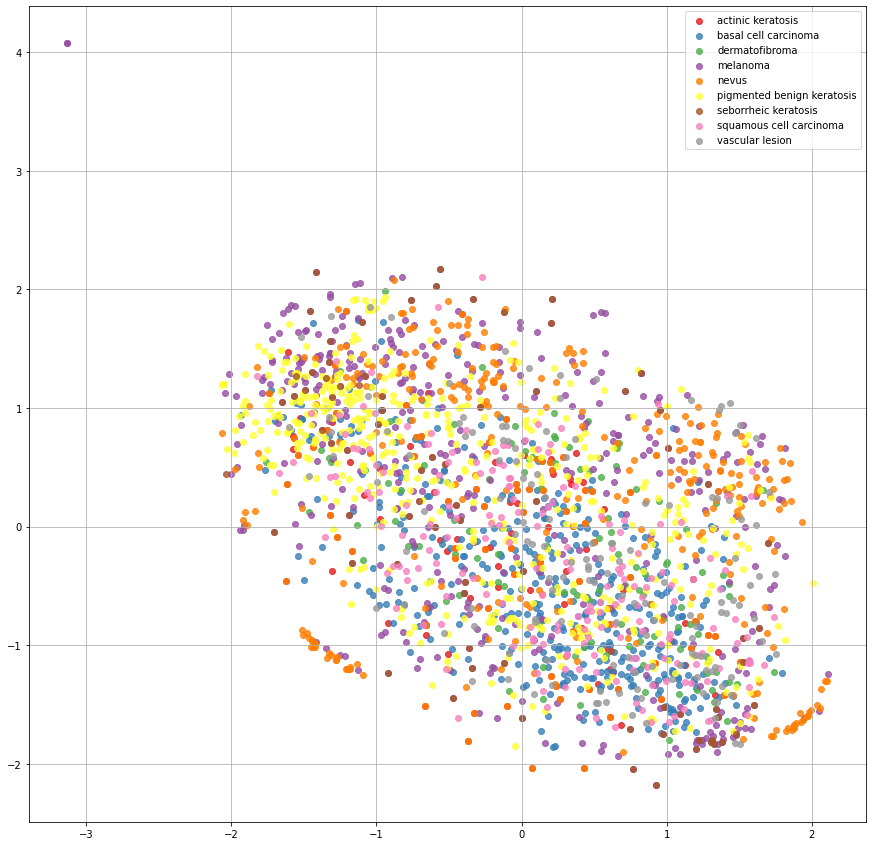

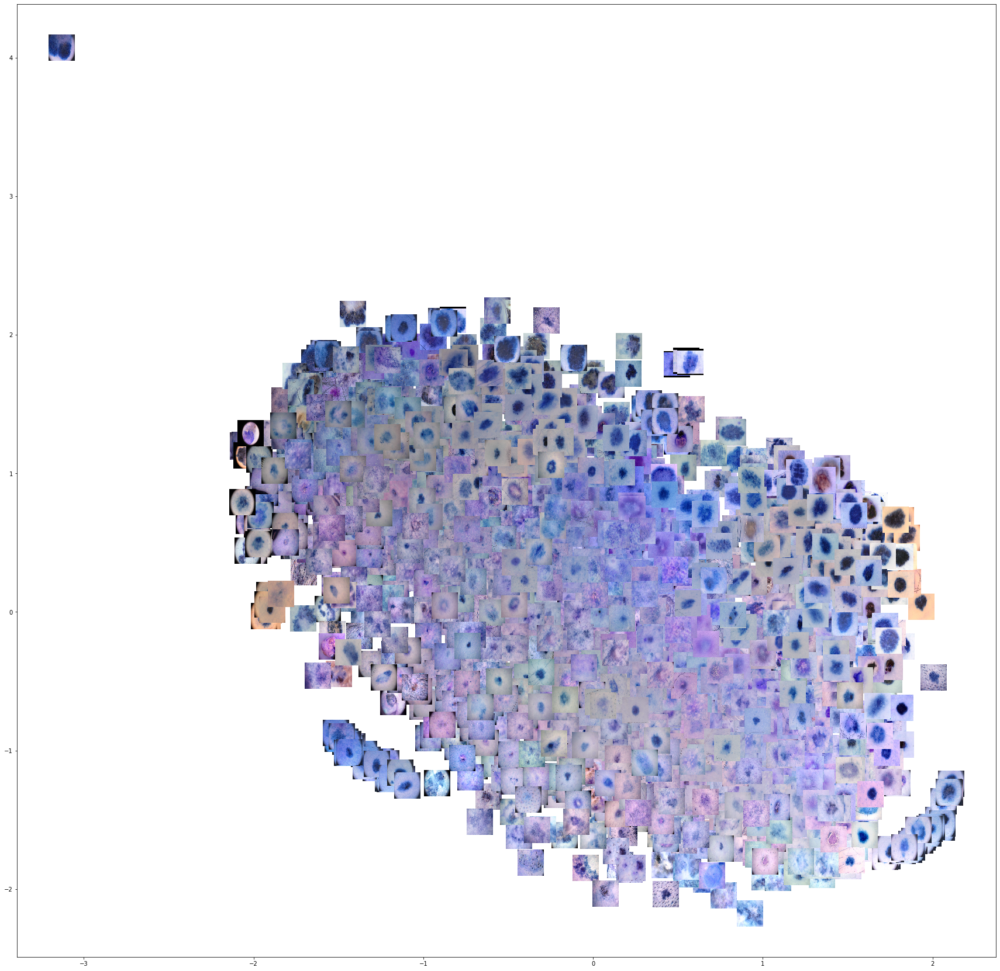

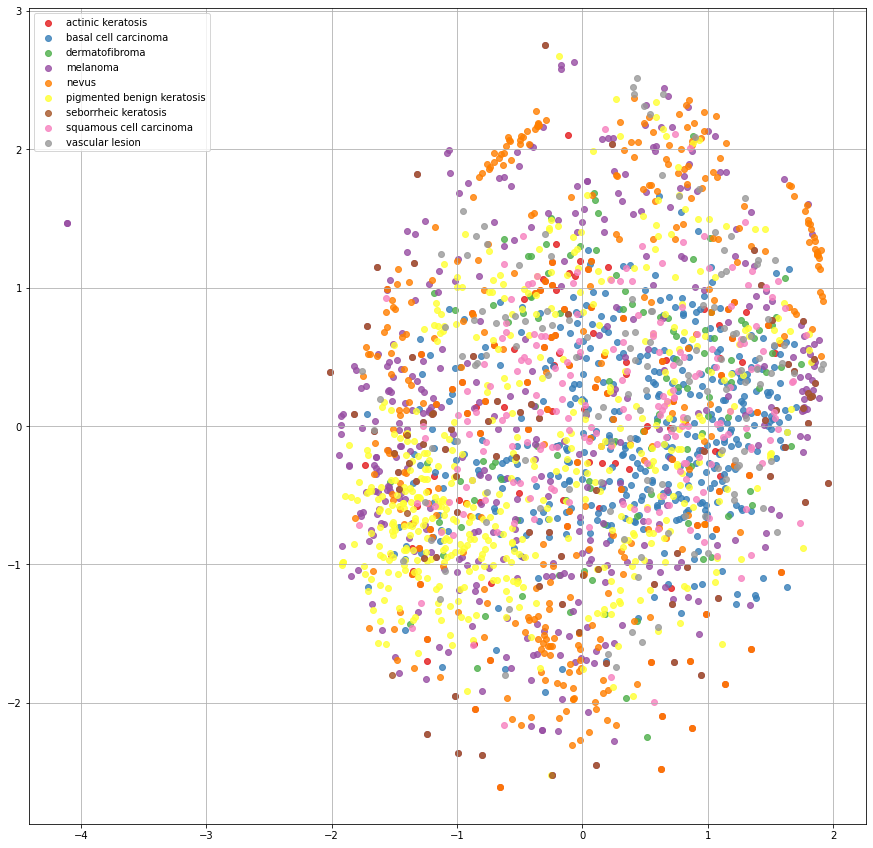

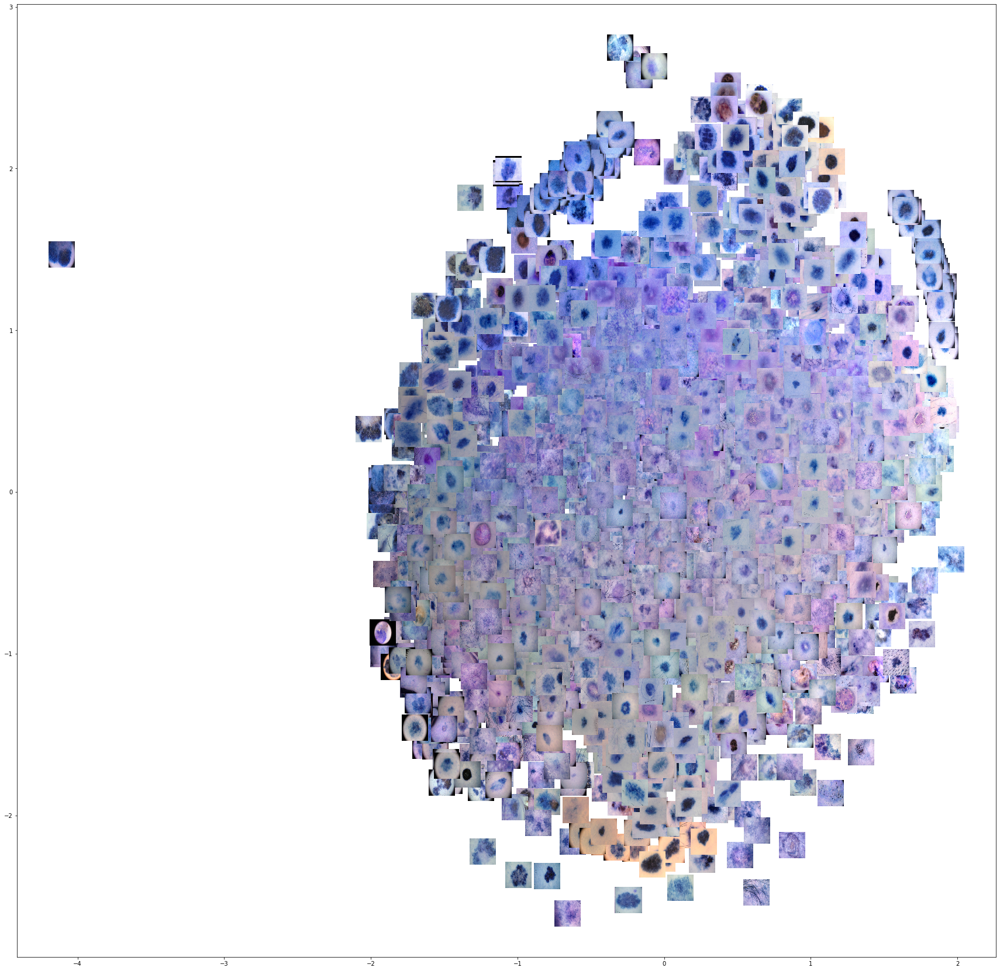

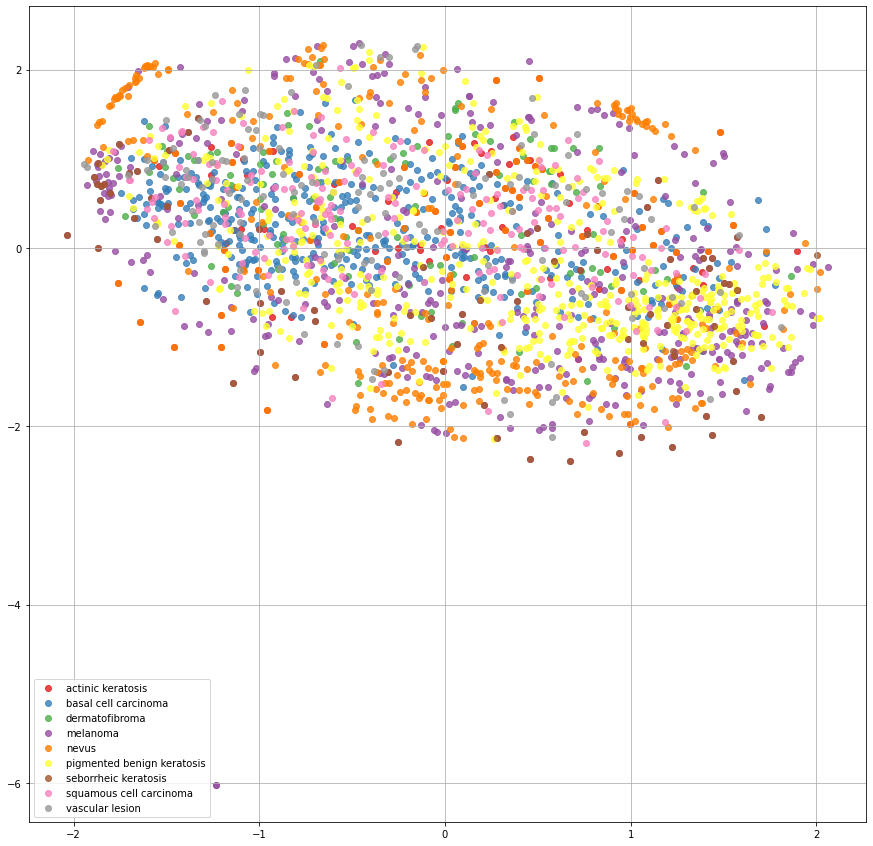

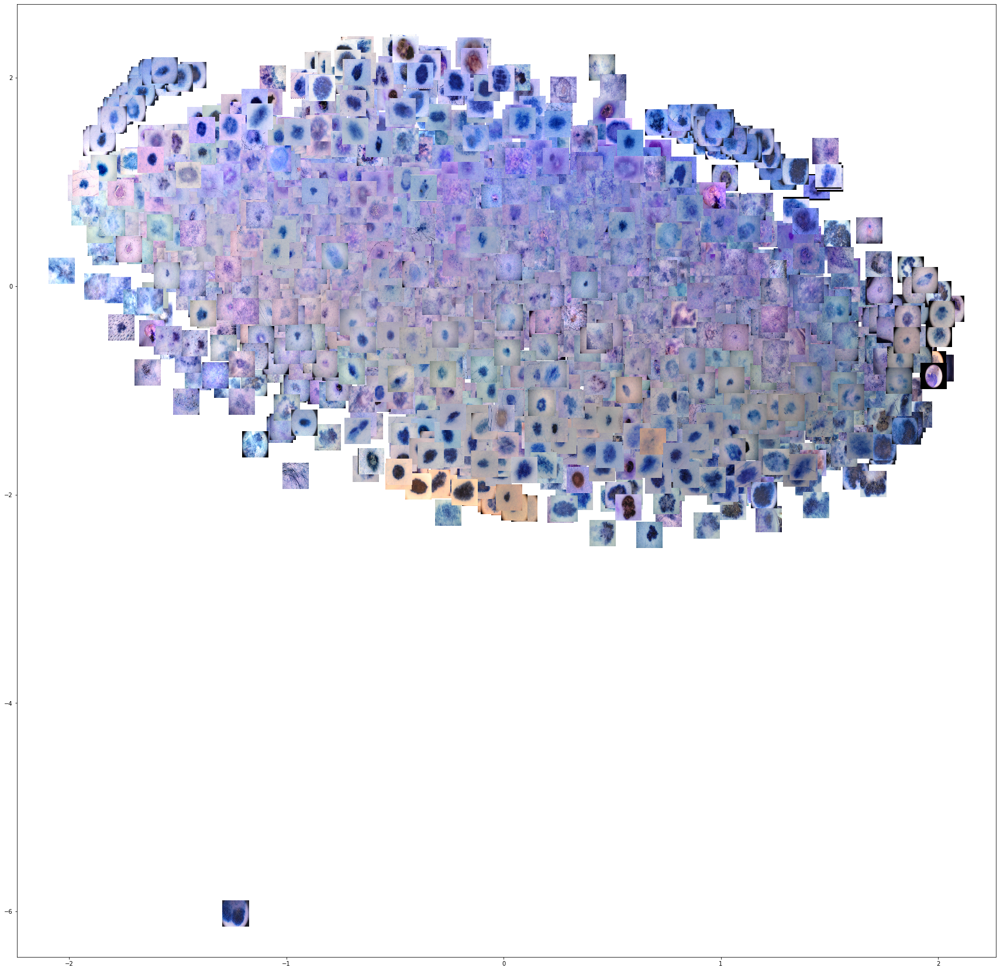

In [44]:
perplexity_list = 50
n_components = 2
n_iter = 4000
learning_rate_list =[20 ,50 , 100 , 200 , 500]

for learning_rate in learning_rate_list:
    tsne = TSNE(n_components=n_components, perplexity=perplexity ,  learning_rate= learning_rate , n_iter= n_iter)
    tsne_result = tsne.fit_transform(pca_result)
    tsne_result_scaled = StandardScaler().fit_transform(tsne_result)
    visualize_scatter(tsne_result_scaled, label_ids)
    visualize_scatter_with_images(tsne_result_scaled, images = [np.reshape(i, (112,112,3)) for i in images], image_zoom=0.4)


# Effect of different values of perplexity

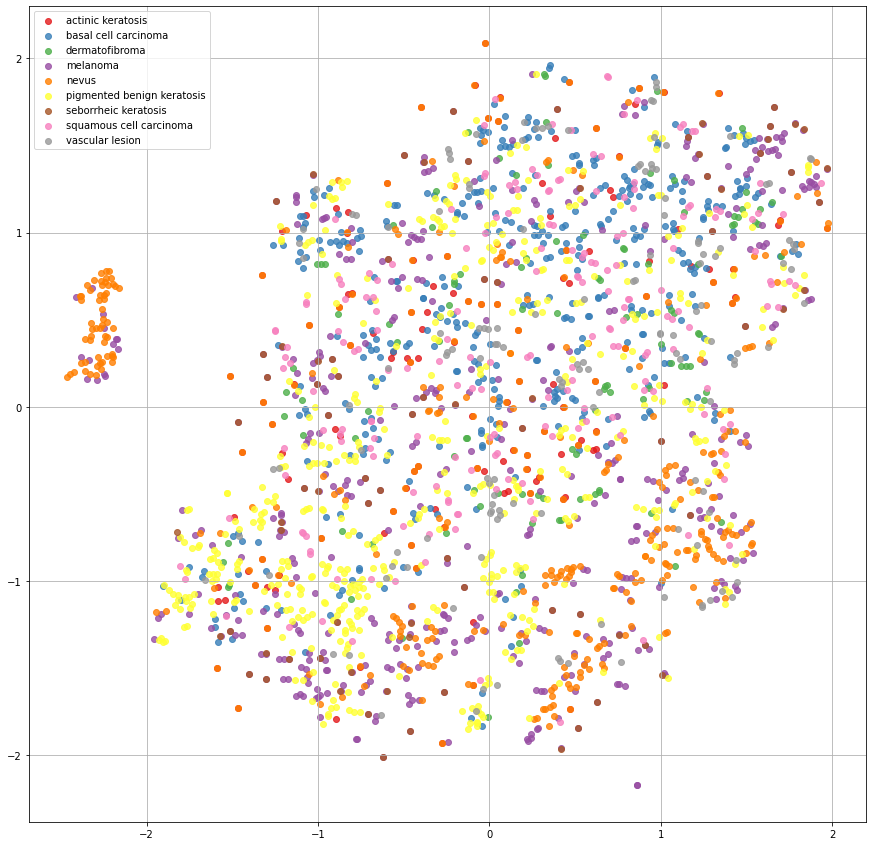

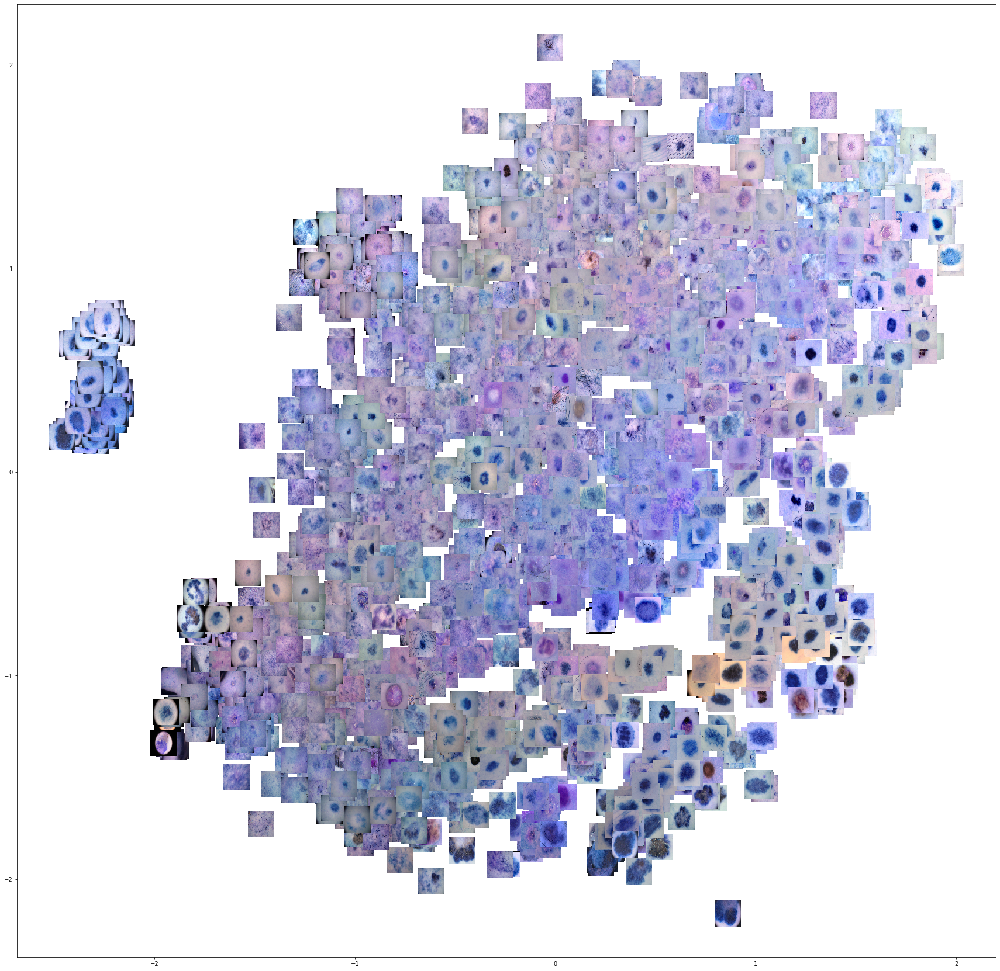

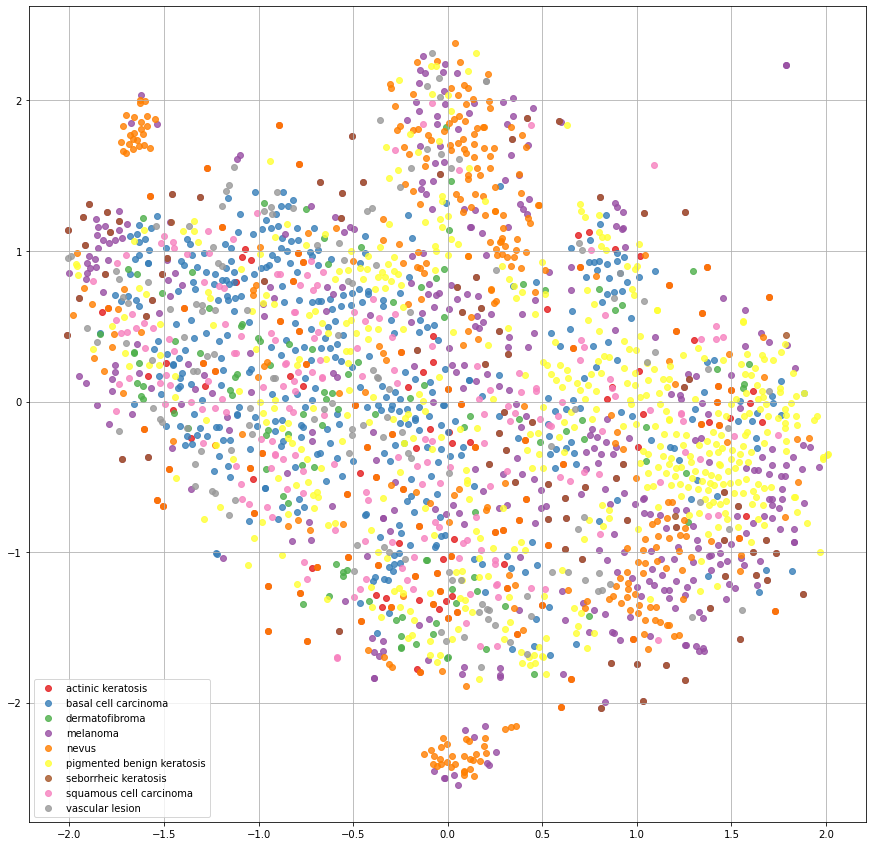

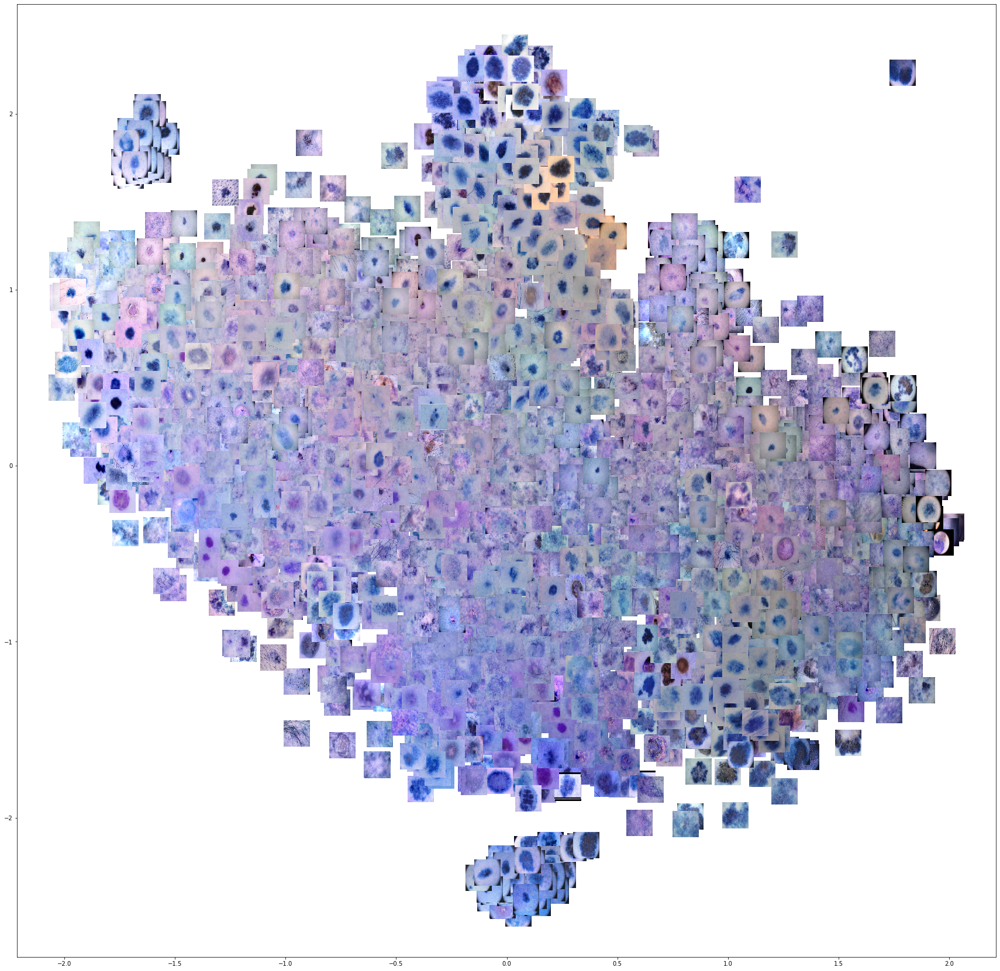

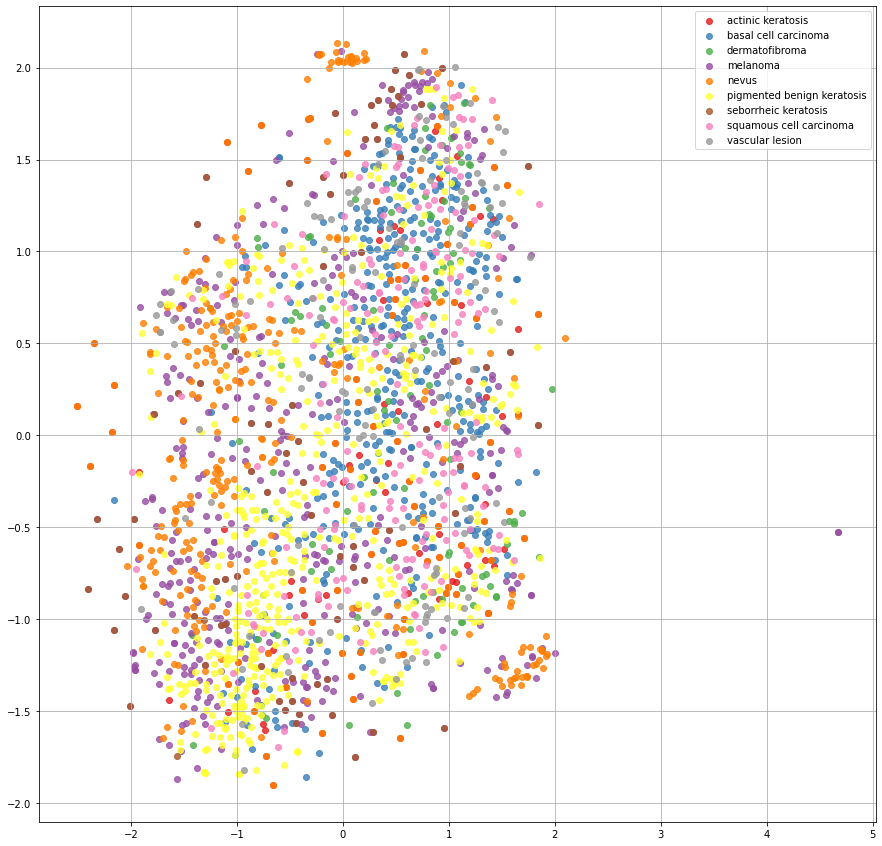

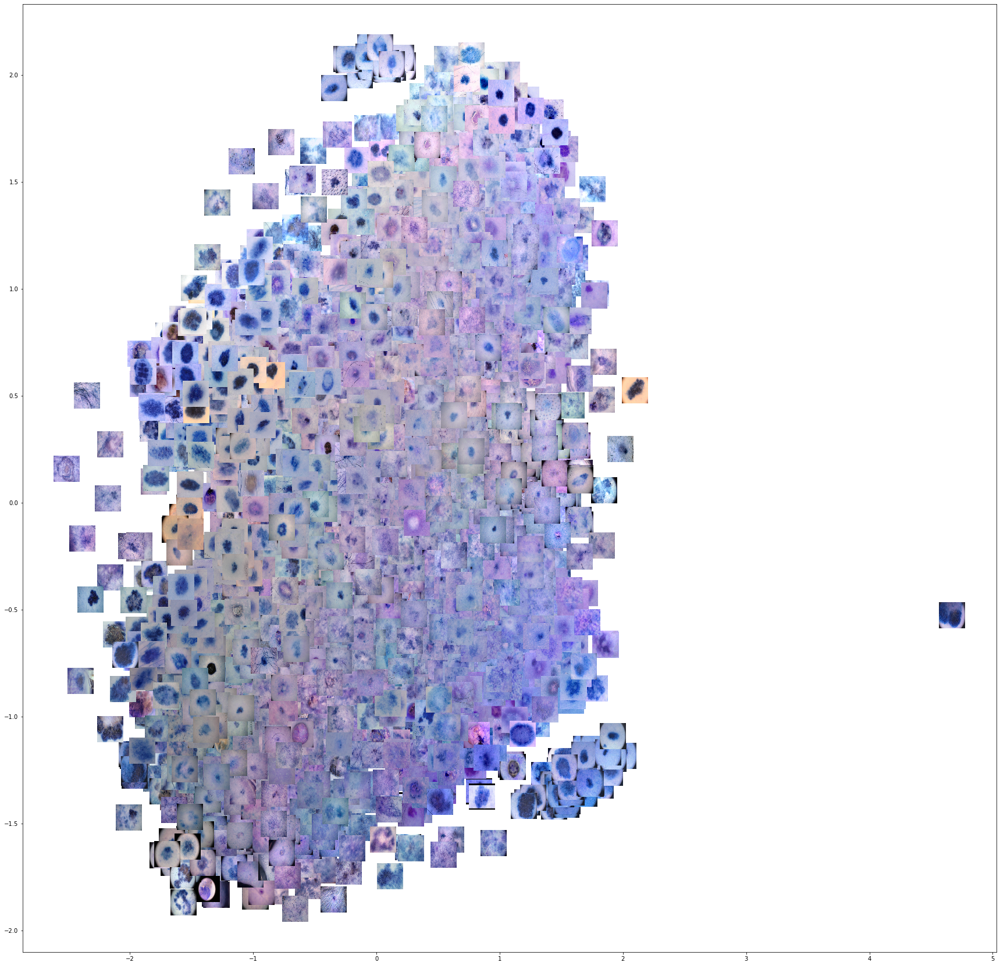

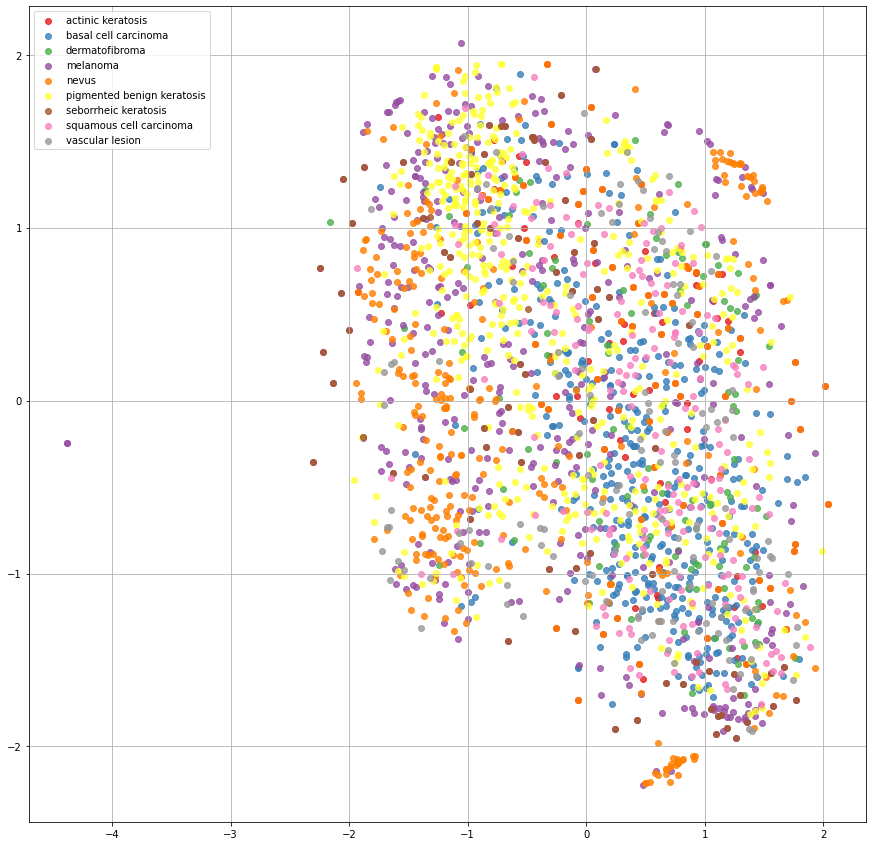

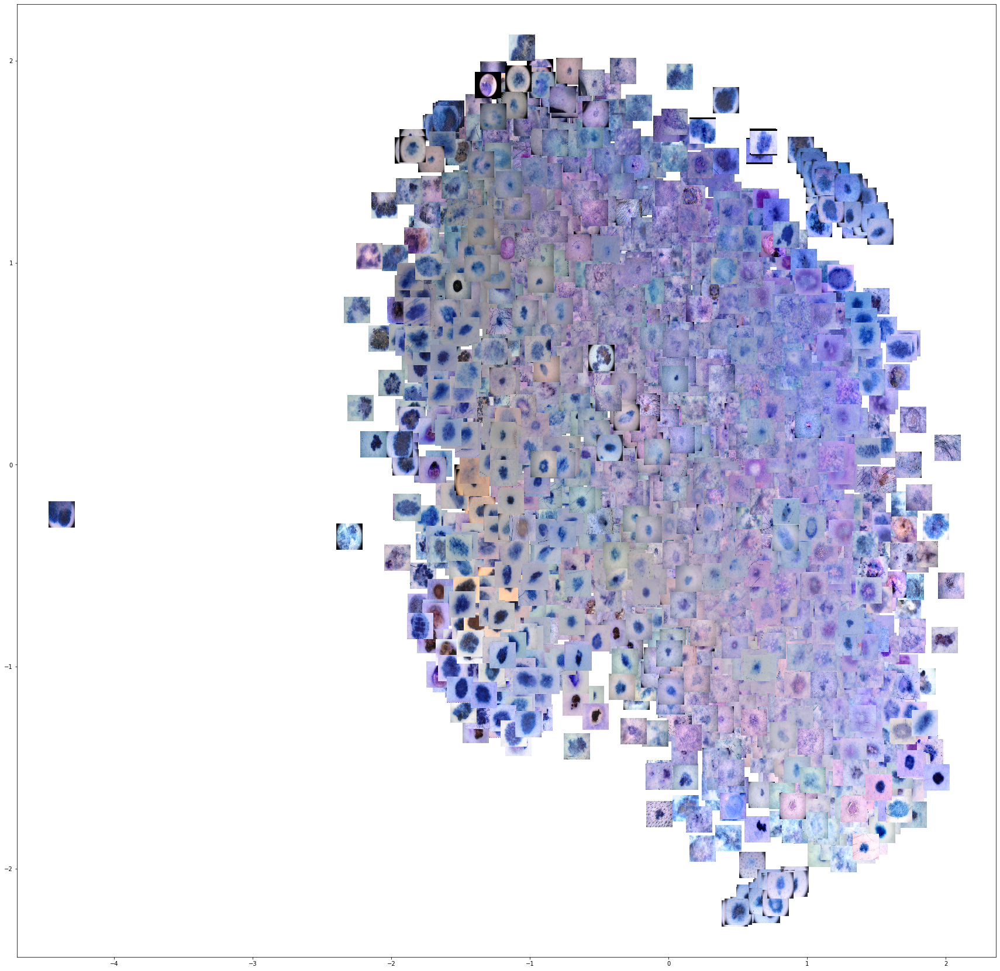

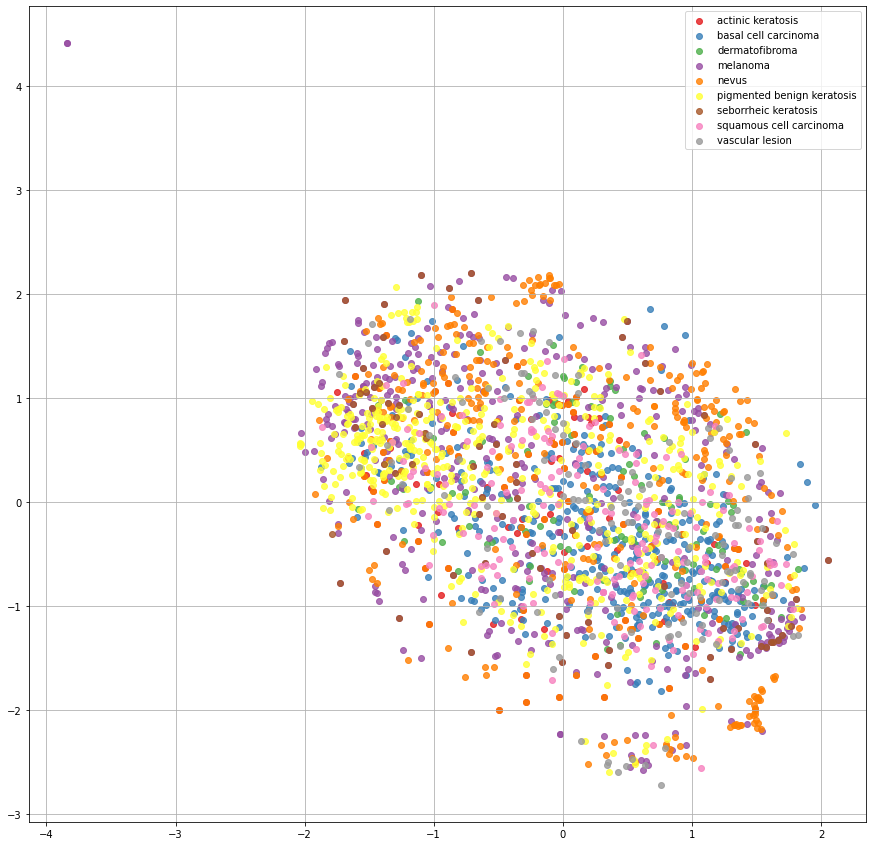

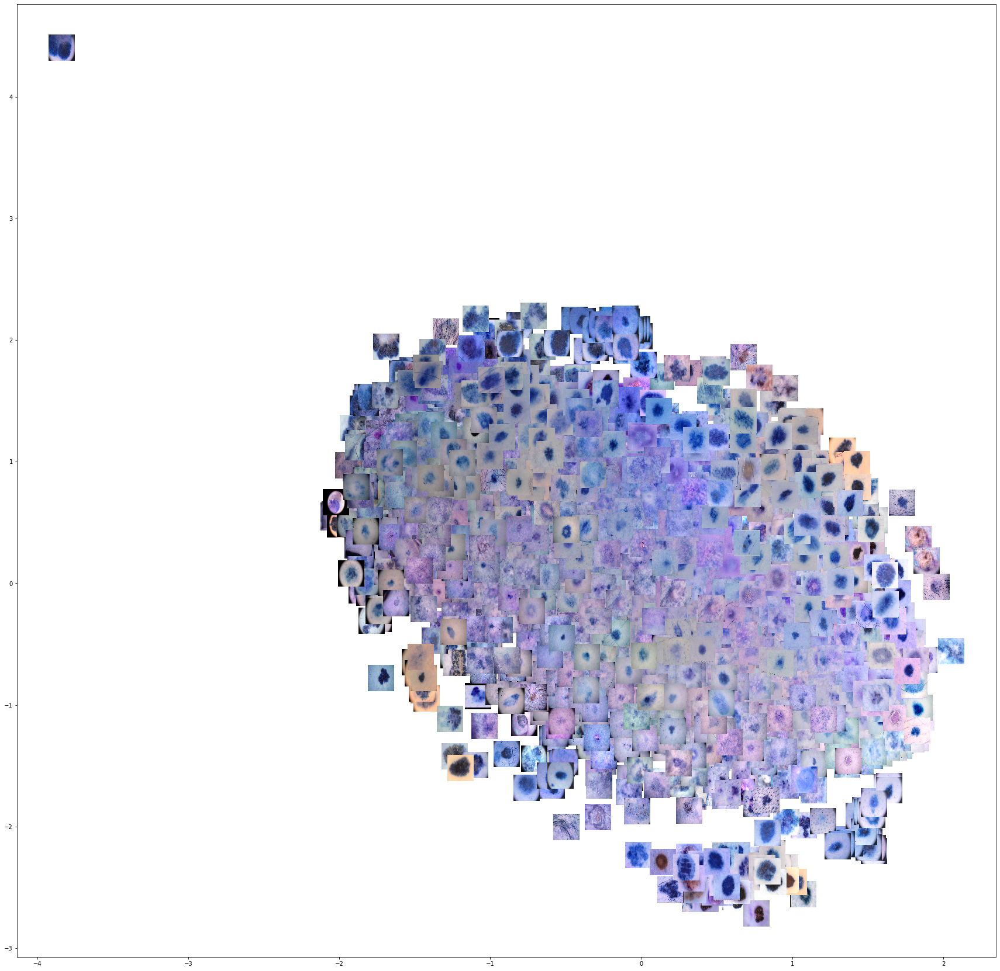

In [43]:
perplexity_list = [10 , 50 ,100, 200 , 400]
n_components = 2
n_iter = 4000
learning_rate_list = 50

for perplexity in perplexity_list:
    tsne = TSNE(n_components=n_components, perplexity=perplexity ,  learning_rate= learning_rate , n_iter= n_iter)
    tsne_result = tsne.fit_transform(pca_result)
    tsne_result_scaled = StandardScaler().fit_transform(tsne_result)
    visualize_scatter(tsne_result_scaled, label_ids)
    visualize_scatter_with_images(tsne_result_scaled, images = [np.reshape(i, (112,112,3)) for i in images], image_zoom=0.4)


# Effect of different values of n_components

n_components = 2 >> to get 2d results


n_components = 3 >>> to get 3d representations


# 3d t-SNE

In [ ]:
tsne = TSNE(n_components=3)
tsne_result = tsne.fit_transform(pca_result)
tsne_result_scaled = StandardScaler().fit_transform(tsne_result)

from mpl_toolkits.mplot3d import Axes3D
from matplotlib import animation

fig = plt.figure(figsize=(25,25))
ax = fig.add_subplot(111,projection='3d')

plt.grid()
    
nb_classes = len(np.unique(label_ids))
    
for label_id in np.unique(label_ids):
    ax.scatter(tsne_result_scaled[np.where(label_ids == label_id), 0],
                tsne_result_scaled[np.where(label_ids == label_id), 1],
                tsne_result_scaled[np.where(label_ids == label_id), 2],
                alpha=0.8,
                color= plt.cm.Set1(label_id / float(nb_classes)),
                marker='o',
                label=id_to_label_dict[label_id])
ax.legend(loc='best')
ax.view_init(20, 40)
ax.set_xlim(-1.5, 1.5)
ax.set_ylim(-1.5, 1.5)
ax.set_zlim(-1.5, 1.5)



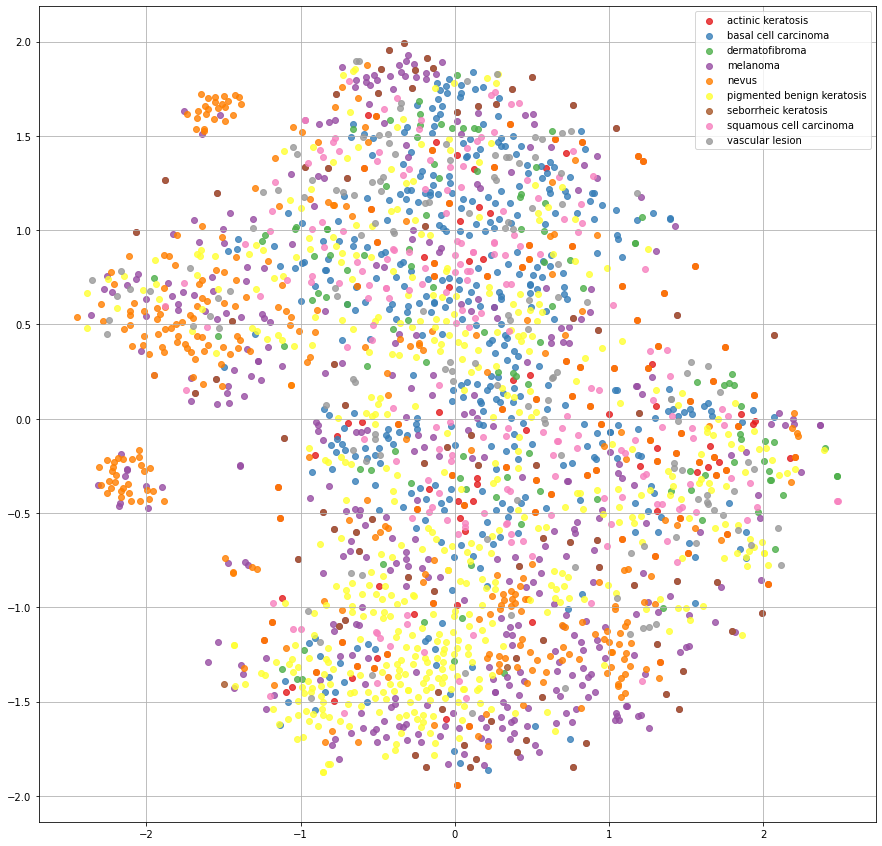

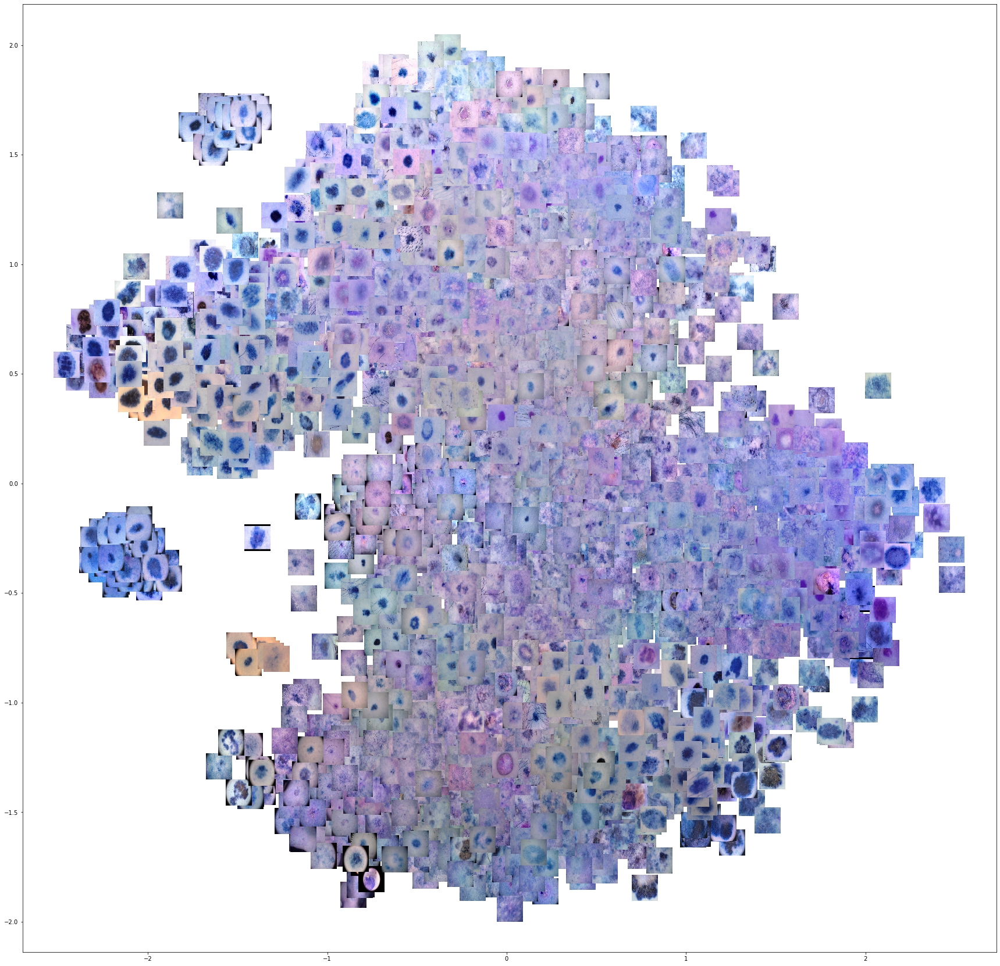

In [45]:
pca = PCA(n_components= 70)
pca_result = pca.fit_transform(images_scaled)
pca_result.shape

tsne = TSNE(n_components=2, perplexity=50.0 ,  learning_rate= 100.0, n_iter= 4000)
tsne_result = tsne.fit_transform(pca_result)
tsne_result_scaled = StandardScaler().fit_transform(tsne_result)
visualize_scatter(tsne_result_scaled, label_ids)

visualize_scatter_with_images(tsne_result_scaled, images = [np.reshape(i, (112,112,3)) for i in images], image_zoom=0.4)